In [1]:
import numpy as np
from scipy.stats import norm
import websocket
import json
import pandas as pd
import requests

In [2]:
class ImpliedVolatilityCall:

    def __init__(self,days_to_maturity,risk_free_rate,underlying_price,strike_price):
        self.time_to_maturity=days_to_maturity/365
        self.risk_free_rate=risk_free_rate
        self.underlying_price=underlying_price
        self.strike_price=strike_price

    def call(self,volatility):

        d1=(np.log(self.underlying_price/self.strike_price)+(self.risk_free_rate+1/2*volatility**2)*self.time_to_maturity)/(np.sqrt(self.time_to_maturity)*volatility)

        d2=d1-volatility*np.sqrt(self.time_to_maturity)

        n1=norm.cdf(d1)
        n2=norm.cdf(d2)

        return self.underlying_price*n1-np.exp(-self.risk_free_rate*self.time_to_maturity)*self.strike_price*n2
    

    def vega_call(self,volatility):
        d1=(np.log(self.underlying_price/self.strike_price)+(self.risk_free_rate+1/2*volatility**2)*self.time_to_maturity)/(np.sqrt(self.time_to_maturity)*volatility)
        return np.sqrt(self.time_to_maturity/(2*np.pi))*self.underlying_price*np.exp(-1/2*d1**2)
    


    def calculate(self,call_price,volatility_guess=0.4,tol=1e-5):
        
        cur=np.full_like(call_price,volatility_guess)
        prev=None
        iter=0
        while prev is None or np.linalg.norm(cur-prev)>tol:
            prev=cur
            cur=prev-(self.call(prev)-call_price)/self.vega_call(prev)
            iter+=1
            if iter>50:
                return -1

        return cur







In [3]:
class ImpliedVolatilityPut:

    def __init__(self,days_to_maturity,risk_free_rate,underlying_price,strike_price):
        self.time_to_maturity=days_to_maturity/365
        self.risk_free_rate=risk_free_rate
        self.underlying_price=underlying_price
        self.strike_price=strike_price

    def put(self,volatility):

        d1=(np.log(self.underlying_price/self.strike_price)+(self.risk_free_rate+1/2*volatility**2)*self.time_to_maturity)/(np.sqrt(self.time_to_maturity)*volatility)

        d2=d1-volatility*np.sqrt(self.time_to_maturity)

        n1=norm.cdf(-d1)
        n2=norm.cdf(-d2)

        return -(self.underlying_price*n1-np.exp(-self.risk_free_rate*self.time_to_maturity)*self.strike_price*n2)
    

    def vega_put(self,volatility):
        d1=(np.log(self.underlying_price/self.strike_price)+(self.risk_free_rate+1/2*volatility**2)*self.time_to_maturity)/(np.sqrt(self.time_to_maturity)*volatility)
        return np.sqrt(self.time_to_maturity/(2*np.pi))*self.underlying_price*np.exp(-1/2*d1**2)
    


    def calculate(self,put_price,volatility_guess=0.4,tol=1e-5):
        
        cur=np.full_like(put_price,volatility_guess)
        prev=None
        iter=0
        while prev is None or np.linalg.norm(cur-prev)>tol:
            prev=cur
            cur=prev-(self.put(prev)-put_price)/self.vega_put(prev)
            iter+=1
            if iter>50:
                return -1

        return cur

In [4]:
def get_option_data(symbol):
    symbol=symbol.upper()
    endpoint="https://eapi.binance.com/eapi/v1/mark"
    
    out = requests.get(endpoint).json()
    df=pd.DataFrame(out)

    filtered_df = df[df['symbol'].str.startswith(f"{symbol}-")]
    return filtered_df


In [5]:
def get_spot_data(symbol):
    symbol=symbol.upper()
    endpoint = f"https://api.binance.com/api/v3/ticker/price?symbol={symbol}USDT"

    out = requests.get(endpoint).json()
  
    return np.float64(out["price"])

In [6]:
option_data=get_option_data("btc")

In [7]:
underlying=get_spot_data("btc")

In [8]:
option_data=option_data[["markPrice","symbol"]]

In [9]:
option_data

,markPrice,symbol
0,31502.6,BTC-250627-55000-C
1,608,BTC-250627-55000-P
2,55668.5,BTC-250627-30000-C
3,83.9,BTC-250627-30000-P
4,18490.4,BTC-250627-70000-C
...,...,...
1311,1992.4,BTC-250415-86000-P
1312,1005,BTC-250415-84000-P
1313,3382.1,BTC-250415-88000-P
1314,2916.4,BTC-250415-83000-C


In [10]:
call=option_data[option_data.symbol.apply(lambda x: x[-1]=="C")]
put=option_data[option_data.symbol.apply(lambda x: x[-1]=="P")]

call["date"]=call.symbol.apply(lambda x:x.split("-")[1])
call["strike"]=call.symbol.apply(lambda x:x.split("-")[2])
del call["symbol"]
put["date"]=put.symbol.apply(lambda x:x.split("-")[1])
put["strike"]=put.symbol.apply(lambda x:x.split("-")[2])
del put["symbol"]

call["date"]=pd.to_datetime(call.date.astype(str),format="%y%m%d")
put["date"]=pd.to_datetime(put.date.astype(str),format="%y%m%d")

call["strike"]=call.strike.astype(float)
put["strike"]=put.strike.astype(float)
call["markPrice"]=call.markPrice.astype(float)
put["markPrice"]=put.markPrice.astype(float)

call["days_to_expiry"]=(call.date-pd.Timestamp.today()).dt.days
put["days_to_expiry"]=(put.date-pd.Timestamp.today()).dt.days
del call["date"]
del put["date"]



C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\3980248721.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  call["date"]=call.symbol.apply(lambda x:x.split("-")[1])
C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\3980248721.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  call["strike"]=call.symbol.apply(lambda x:x.split("-")[2])
C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\3980248721.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc

In [11]:
call

,markPrice,strike,days_to_expiry
0,31502.6,55000.0,75
2,55668.5,30000.0,75
4,18490.4,70000.0,75
6,45886.6,40000.0,75
8,514.9,140000.0,75
...,...,...,...
1303,1674.9,85000.0,2
1304,2239.9,84000.0,2
1305,1215.0,86000.0,2
1306,604.8,88000.0,2


In [12]:
rf=0.05

def get_iv_call(row):
    return ImpliedVolatilityCall(row["days_to_expiry"],rf,underlying,row["strike"]).calculate(row["markPrice"])

call["volatility"] = call.apply(get_iv_call, axis=1)
call.dropna(inplace=True)

def get_iv_put(row):
    return ImpliedVolatilityPut(row["days_to_expiry"],rf,underlying,row["strike"]).calculate(row["markPrice"])

put["volatility"] = put.apply(get_iv_put, axis=1)
put.dropna(inplace=True)

C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\955029120.py:34: RuntimeWarning: divide by zero encountered in scalar divide
  cur=prev-(self.call(prev)-call_price)/self.vega_call(prev)
C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\955029120.py:11: RuntimeWarning: invalid value encountered in scalar divide
  d1=(np.log(self.underlying_price/self.strike_price)+(self.risk_free_rate+1/2*volatility**2)*self.time_to_maturity)/(np.sqrt(self.time_to_maturity)*volatility)
C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\955029120.py:22: RuntimeWarning: invalid value encountered in scalar divide
  d1=(np.log(self.underlying_price/self.strike_price)+(self.risk_free_rate+1/2*volatility**2)*self.time_to_maturity)/(np.sqrt(self.time_to_maturity)*volatility)
C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\955029120.py:11: RuntimeWarning: divide by zero encountered in scalar divide
  d1=(np.log(self.underlying_price/self.strike_price)+(self.risk_free_rate+1/2*volatility**2)*self.time_to_maturity

In [13]:
call["log_moneyness"]=np.log(call["strike"]/underlying) #OBS EDITED
put["log_moneyness"]=np.log(put["strike"]/underlying)
del call["strike"]
del put["strike"]

C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\2635748597.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  call["log_moneyness"]=np.log(call["strike"]/underlying) #OBS EDITED
C:\Users\Isac\AppData\Local\Temp\ipykernel_23244\2635748597.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  put["log_moneyness"]=np.log(put["strike"]/underlying)


In [14]:
put

,markPrice,days_to_expiry,volatility,log_moneyness
1,608.0,75,0.662875,-0.437555
5,2343.4,75,0.566830,-0.196393
9,53431.4,75,0.440618,0.496754
11,3622.2,75,0.552063,-0.127400
13,25658.8,75,0.542565,0.255592
...,...,...,...,...
1310,285.0,2,0.639206,-0.050439
1311,1992.4,2,0.620514,0.009459
1312,1005.0,2,0.615012,-0.014072
1313,3382.1,2,0.634919,0.032448


In [15]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

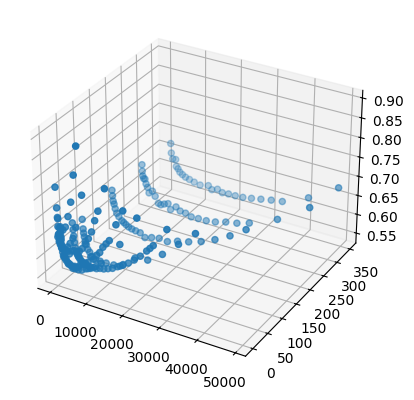

In [16]:
ax=plt.axes(projection="3d")
ax.scatter(call.markPrice,call.days_to_expiry,call.volatility)
plt.show()

In [17]:
import plotly.graph_objects as go

In [18]:
call_pivot=call.pivot(values="volatility",index="days_to_expiry",columns="log_moneyness")
put_pivot=put.pivot(values="volatility",index="days_to_expiry",columns="log_moneyness")


In [19]:
call_pivot

log_moneyness,-0.756009,-0.532866,-0.437555,-0.350544,-0.286005,-0.270501,-0.255234,-0.225381,-0.196393,-0.168222,...,0.630285,0.690910,0.748068,0.802136,0.853429,0.902219,0.948739,0.993191,1.035750,1.115793
days_to_expiry,,,,,,,,,,,,,,,,,,,,,
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.805500,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.757172,0.717145,0.671686,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19,NaN,NaN,NaN,NaN,NaN,0.743302,NaN,NaN,0.663187,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
47,NaN,NaN,NaN,0.711181,0.659723,0.649919,0.640631,0.622186,0.607296,0.594462,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75,NaN,NaN,0.696451,0.655973,NaN,0.617436,NaN,NaN,0.590706,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
166,NaN,0.660950,0.632743,0.611172,NaN,0.595224,NaN,NaN,0.584527,NaN,...,0.614040,0.625239,0.632576,0.646158,0.660453,NaN,NaN,NaN,NaN,NaN
257,0.683553,0.629143,NaN,0.598053,NaN,0.588003,NaN,NaN,0.582338,NaN,...,0.600121,0.613806,0.622193,0.634161,0.634578,0.640842,0.653287,0.670339,NaN,NaN


In [20]:
X, Y = np.meshgrid(call_pivot.columns, call_pivot.index)
Z = call_pivot.values

fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale='Viridis')])

fig.update_layout(
    title='Implied Volatility Surface',
    scene=dict(
        xaxis_title='Log Moneyness',
        yaxis_title='Days to Expiry',
        zaxis_title='Implied Volatility',
    ),
    autosize=True,
    height=700
)

fig.show()

In [21]:
X, Y = np.meshgrid(put_pivot.columns, put_pivot.index)
Z = put_pivot.values

fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale='Viridis')])

fig.update_layout(
    title='Implied Volatility Surface',
    scene=dict(
        xaxis_title='Log Moneyness',
        yaxis_title='Days to Expiry',
        zaxis_title='Implied Volatility',
    ),
    autosize=True,
    height=700
)

fig.show()

<Axes: xlabel='days_to_expiry'>

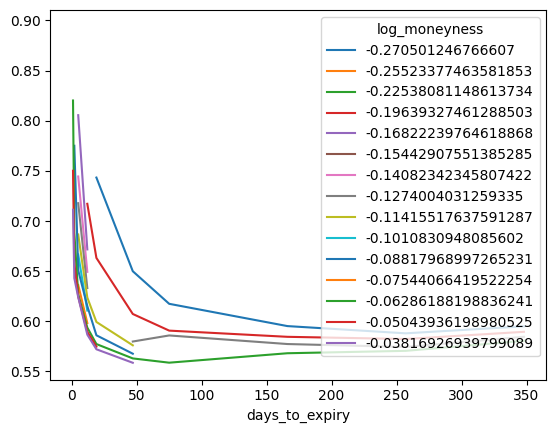

In [22]:
call_pivot.iloc[:, 5:20].plot()

<Axes: xlabel='log_moneyness'>

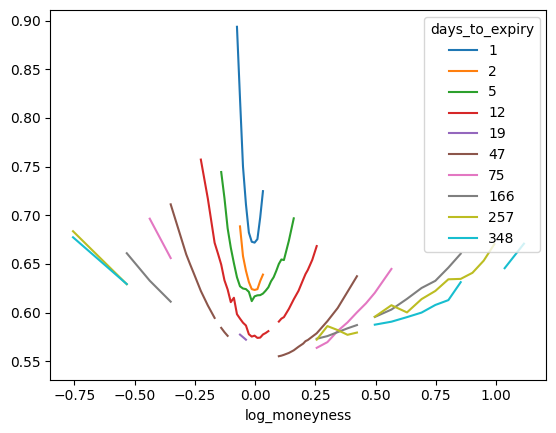

In [23]:
call_pivot.T.plot()

In [24]:
from scipy.optimize import curve_fit

In [25]:
def vol_model(moneyness_maturity,a,b,c,d,e,f,):
    moneyness=moneyness_maturity[:,0]
    maturity=moneyness_maturity[:,1]/365
    return 1/maturity*(a+b*moneyness+c*moneyness**2+d*moneyness**3)+e+np.exp(-f*moneyness*maturity)

In [26]:
moneyness_maturity=np.column_stack((call["log_moneyness"], call["days_to_expiry"]))

In [27]:
cof=curve_fit(vol_model,np.column_stack((call["log_moneyness"], call["days_to_expiry"])),call["volatility"])[0]

In [28]:
cof

array([ 2.90925162e-04, -1.32210703e-03,  8.57540673e-02, -5.99840085e-02,
       -4.32136780e-01, -2.87610587e-02])

In [29]:
test_moneyness=np.linspace(-0.7,1,500)
test_maturity=np.linspace(1,365,500)
TEST_MONEYNESS,TEST_MATURITY=np.meshgrid(test_moneyness,test_maturity)

grid_input = np.column_stack((TEST_MONEYNESS.ravel(), TEST_MATURITY.ravel()))

# Step 2: Evaluate the model over the grid
model_vol_surface = vol_model(grid_input, *cof)  # shape (250000,)

# Step 3: Reshape back to 2D grid for plotting
model_vol_surface = model_vol_surface.reshape(TEST_MONEYNESS.shape)

In [30]:
model_vol_surface

array([[23.85860697, 23.59892526, 23.34103218, ...,  9.62033003,
         9.60937751,  9.59763207],
       [14.0348694 , 13.88471771, 13.73560024, ...,  5.80223019,
         5.79589758,  5.7891065 ],
       [10.03969879,  9.93409121,  9.82921104, ...,  4.2495079 ,
         4.24505425,  4.24027813],
       ...,
       [ 0.61207714,  0.61145849,  0.61084477, ...,  0.62162332,
         0.62169361,  0.62176172],
       [ 0.61190941,  0.61129238,  0.61068026, ...,  0.62163219,
         0.62170275,  0.62177113],
       [ 0.6117422 ,  0.61112677,  0.61051626, ...,  0.62164127,
         0.62171209,  0.62178075]])

In [31]:

from mpl_toolkits.mplot3d import Axes3D

fig = go.Figure(data=[
    go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', name='Market Surface'),
    go.Surface(z=model_vol_surface, x=TEST_MONEYNESS, y=TEST_MATURITY, colorscale='Blues', opacity=0.6, name='Fitted Model')
])

fig.update_layout(
    title='Implied Volatility: Market vs Fitted Model',
    scene=dict(
        xaxis_title='Log Moneyness',
        yaxis_title='Days to Expiry',
        zaxis_title='Implied Volatility',
        zaxis=dict(range=[0, 1])
    ),
    autosize=True,
    height=700
)

fig.show()